In [1]:
%matplotlib inline
from pymongo import MongoClient
import pymongo
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.style as mstyle
mstyle.use('bmh')
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

In [2]:
db=MongoClient(host='localhost',port=27017).mydb.cwdb
df = pd.DataFrame(list(db.find({'language': {'$eq': 'PHP'}}).sort([('publication_date', pymongo.ASCENDING)])))

In [3]:
df.head()

,_id,city,skills,experience,language,position,education,salary,company_size,publication_date
0,60a665ce8a4cc7231e043167,Винница,"[Azure, KISS, RabbitMQ, PostgreSQL]",0.50,PHP,Software Engineer,Незаконченное высшее,81.25,100,2011-01-01
1,60a665ce8a4cc7231e042e47,Ивано-Франковск,"[PostgreSQL, CD, Azure, CI]",2.00,PHP,Senior Software Engineer,Высшее,1000.00,10,2011-01-02
2,60a665ce8a4cc7231e042f48,Харьков,"[gRPC, RabbitMQ, Jenkins, HTML, WebSockets]",0.25,PHP,Junior Software Engineer,Незаконченное высшее,1500.00,10,2011-01-02
3,60a665ce8a4cc7231e043050,Запорожье,[SCSS],3.00,PHP,Senior Software Engineer,Высшее,1200.00,50,2011-01-02
4,60a665ce8a4cc7231e04321b,Харьков,"[gRPC, KISS, Less, CI]",3.00,PHP,Software Engineer,Высшее,1000.00,10,2011-01-02


## Залежність ЗП від посади для  Python-розробників

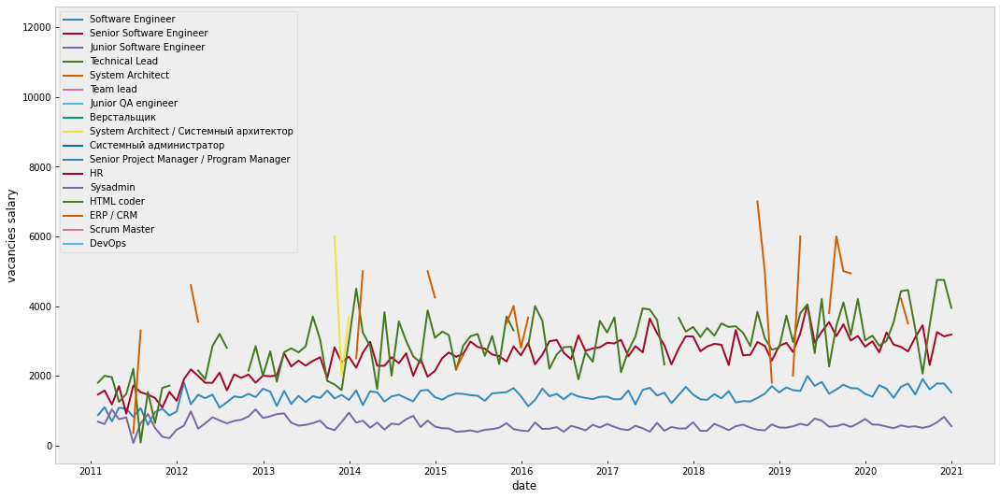

In [4]:
df.set_index('publication_date', drop=False, inplace=True)
df.index = pd.to_datetime(df.index, format='%d/%m/%Y %H:%M')
fig, ax = plt.subplots(figsize=(18, 9))
for position in df['position'].unique():
    subDf = df[df['position'] == position]
    subDf = subDf.resample('M').mean()
    ax.plot(subDf['salary'], label=position)
ax.legend(loc='best')
ax.set(xlabel='date', ylabel='vacancies salary', title='')
ax.grid()
plt.show()

## Лінія регресіі залежності ЗП від досвіду роботи

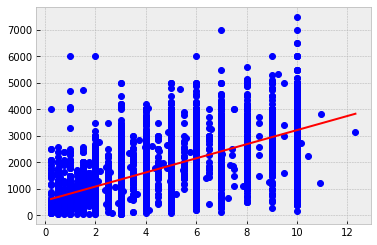

In [5]:
import numpy as np
import matplotlib.pyplot as plt 
from scipy import stats
edf=df[df['salary']<8000]
y= edf['salary']
x = edf['experience']
gradient, intercept, r_value, p_value, std_err = stats.linregress(x,y)
mn=np.min(x)
mx=np.max(x)
x1=np.linspace(mn,mx,100)
y1=gradient*x1+intercept
plt.plot(x,y,'ob')
plt.plot(x1,y1,'-r')
plt.show()

In [6]:
df=pd.DataFrame(list(db.find()))

## Розподіл кількості вакансій за очікуваною ЗП

<AxesSubplot:ylabel='Frequency'>

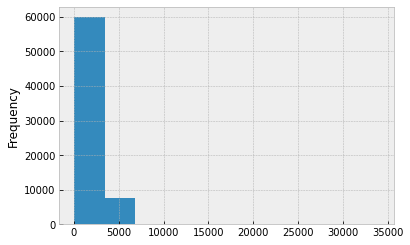

In [7]:
df['salary'].plot.hist(bins=10)

<AxesSubplot:ylabel='Frequency'>

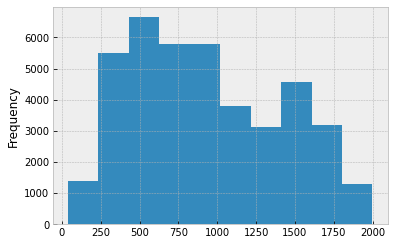

In [8]:
df[df['salary']<2000]['salary'].plot.hist(bins=10)

## Кругова діаграма відсотку вакансій на кожну мову програмування

<AxesSubplot:ylabel='None'>

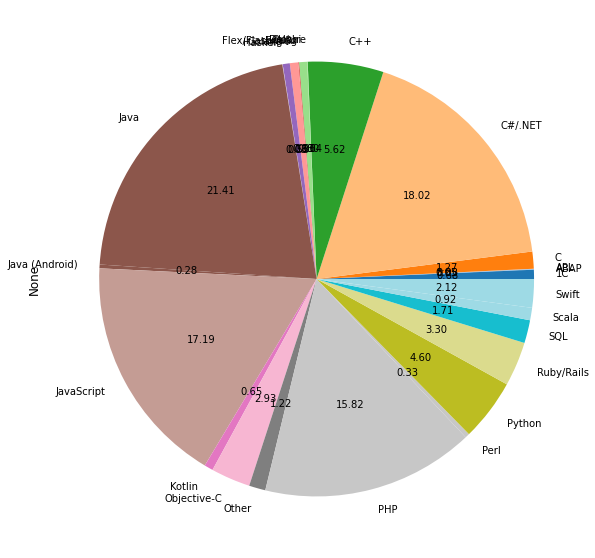

In [9]:
a=df.groupby('language').size()
a.plot.pie(figsize=(10,10),autopct='%.2f',colormap='tab20')

## Розподіл кількості вакансій опублікованих компаніями різного розміру в залежності за роками

In [11]:
print(df.pivot)
df = df.pivot(index='publication_date', columns='position', values='salary')
df.plot.bar(figsize=(10,10))

<bound method DataFrame.pivot of                             _id      city  \
0      60a665ce8a4cc7231e042ddd      Киев   
1      60a665ce8a4cc7231e042dde    Днепр.   
2      60a665ce8a4cc7231e042ddf     Львов   
3      60a665ce8a4cc7231e042de0     Львов   
4      60a665ce8a4cc7231e042de1   Харьков   
...                         ...       ...   
67647  60a666306f2491a4b267ab3d     Львов   
67648  60a666306f2491a4b267ab3e  Чернигов   
67649  60a666306f2491a4b267ab3f      Киев   
67650  60a666306f2491a4b267ab40   Ужгород   
67651  60a666306f2491a4b267ab41      Киев   

                                      skills  experience     language  \
0      [Azure, OOP, Stateless, Deep leaning]    3.000000       Python   
1                   [Docker, Stateless, OOP]    0.500000         Java   
2       [PostgreSQL, gRPC, Kafka, Stateless]    2.000000          NaN   
3                    [CI, AWS, OOP, Jenkins]    1.000000          NaN   
4                              [gRPC, MySQL]    0.750000  Obj

KeyError: 'year'

## Залежність ЗП у ваканції для фахівця з менше ніж 2 рік роботи в залежності від розміру компаніі

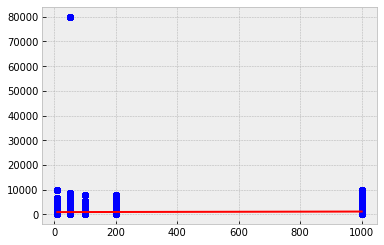

In [14]:
import numpy as np
import matplotlib.pyplot as plt 
from scipy import stats

df=pd.DataFrame(list(db.find({'experience':{'$lte':2}})))
y= df['salary']
x = df['company_size']
gradient, intercept, r_value, p_value, std_err = stats.linregress(x,y)
mn=np.min(x)
mx=np.max(x)
x1=np.linspace(mn,mx,100)
y1=gradient*x1+intercept
plt.plot(x,y,'ob')
plt.plot(x1,y1,'-r')
plt.show()